# EDA Report: Sentiment Analysis of Sephora Product Reviews
*Author: Szymon Stano*

The aim of this report is to conduct a basic exploratory data analysis of the *Sephora Products and Skincare Reviews* dataset, as part of preparing it for sentiment model training.


In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from ydata_profiling import ProfileReport
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from pandas.plotting import scatter_matrix
sns.set_theme()

In [2]:
df = pd.read_csv("/app/data/train_test/train_data.csv", engine='python')

## 1. Basic Data Analysis

We are working with the *Sephora Products and Skincare Reviews* dataset, which has undergone initial preprocessing (columns irrelevant to classification have been removed), and has been enriched with features that may hold value for classification tasks:
- `review_length` - length of the review (number of characters)
- `has_exclamation` - indicator of whether an exclamation mark appears in the title or content of the review
- `positive_word_count` - number of positively charged words in the title or content of the review
- `negative_word_count` - number of negatively charged words in the title or content of the review

The dataset under analysis is the training set, which comprises 80% of the original data.


In [3]:
df.shape

(741138, 40)

In total, we have over 700,000 reviews, containing 39 columns with respective features, along with the `LABEL-is_recommended` label, which is a categorical variable indicating whether the review was positive (`1`) or negative (`0`). 

Right from the start, we can observe that these classes are imbalanced, with a significantly higher number of positive reviews. To build an accurate sentiment model, addressing this imbalance may prove important — for example, by augmenting data for the minority class.


Text(0.5, 1.0, 'Rozkład klas')

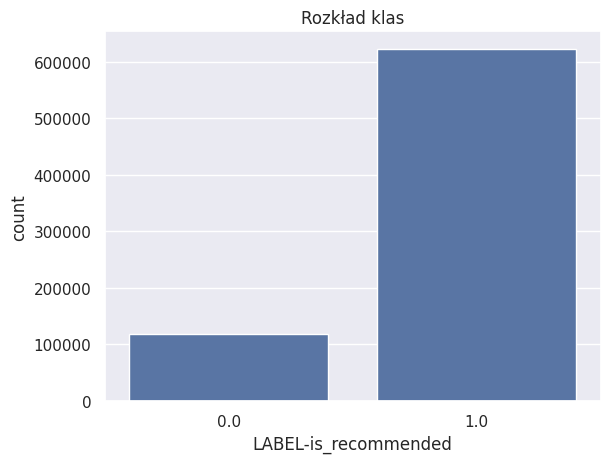

In [4]:
sns.countplot(x=df['LABEL-is_recommended'])
plt.title("Rozkład klas")

Below are sample entries from the dataset

In [5]:
pd.set_option('display.max_columns', None)
df.sample(3)

,helpfulness,total_feedback_count,total_neg_feedback_count,total_pos_feedback_count,review_text,review_title,skin_tone,eye_color,skin_type,hair_color,product_id,price_usd,brand_id,loves_count,rating,reviews,size,variation_type,variation_value,variation_desc,ingredients,value_price_usd,sale_price_usd,limited_edition,new,online_only,out_of_stock,sephora_exclusive,highlights,primary_category,secondary_category,tertiary_category,child_count,child_max_price,child_min_price,review_length,has_exclamation,positive_word_count,negative_word_count,LABEL-is_recommended
241503,0.924528,53,4.0,49,The old formula was my holy grail for brighten...,new formula :(,light,blue,combination,brown,P94421,82.0,4171.0,166423.0,4.2442,2911.0,1 oz/ 30 mL,Size,1 oz/ 30 mL,NaN,"['Aqua/Water/Eau, Butylene Glycol, Glycerin, C...",NaN,NaN,0.0,0.0,0.0,0.0,0.0,"['Vegan', 'Good for: Dullness/Uneven Texture',...",Skincare,Treatments,Face Serums,0.0,NaN,NaN,756.0,1,0,0,0.0
198775,NaN,0,0.0,0,I used to use this religiously a couple years ...,NaN,mediumTan,brown,oily,brown,P309308,122.0,6073.0,262434.0,4.3375,5393.0,1.7 oz/ 50 mL,Size,1.7 oz/ 50 mL,NaN,"['Botanical Blend [Aqua, Opuntia Tuna Fruit Ex...",142.0,NaN,0.0,0.0,0.0,0.0,0.0,"['Good for: Dullness/Uneven Texture', 'Lactic ...",Skincare,Treatments,Face Serums,2.0,85.0,43.0,377.0,1,1,0,1.0
478022,0.000000,1,1.0,0,“Gifted by Glow Recipe” Really lovely Hyaluron...,Plump and soft!,fair,blue,combination,blonde,P462699,45.0,6189.0,159339.0,4.4249,1918.0,1.0 oz/ 30 mL,Size,1.0 oz/ 30 mL,NaN,"['Aqua/Water/Eau, Glycerin, Propanediol, Penty...",NaN,NaN,0.0,0.0,0.0,0.0,1.0,"['Hyaluronic Acid', 'Good for: Dullness/Uneven...",Skincare,Treatments,Face Serums,0.0,NaN,NaN,415.0,1,1,0,1.0


As part of the analysis of feature types and their approximate distributions, a report was generated using the `ydata-profiling` library. It was created based on 20% of the total dataset due to the large size of the original data. The report presents basic statistics for a randomly sampled subset of records for each feature, which should be representative of the overall dataset, though some deviations from full dataset statistics are possible.

The most important insights provided by the report include:
- Number of features by type:
    - Categorical - 17  
    - Numerical - 16
    - Text - 7
    
(the `brand_id` variable should belong to the categorical data, hence the discrepancy in counts)

- The `primary_category` feature appears to take only a single value — *Skincare* — which may render this column redundant

- The `helpfulness` column contains about 50% missing values — this could be due to the way this feature is calculated: *helpfulness = total_pos_feedback_count / total_feedback_count*, where `NaN` values may arise when there is no feedback at all for a product. This feature is a numerical (continuous) variable ranging from 0 to 1. One possible approach is to replace missing values with 0.5, which could indicate a neutral level of `helpfulness` (due to lack of positive or negative opinions), but this would significantly alter the distribution.

- The `variation_desc`, `value_price_usd`, and `sale_price_usd` columns have missing values in approximately 98% of all rows — this is likely due to the absence of product variants and a lack of promotional pricing for certain products.


In [6]:
df_sample = df.sample(frac=0.20, random_state=42)  # 20% danych
profile = ProfileReport(df_sample, title="Raport Profilowania", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


  0%|                                                                                                                                | 0/40 [00:00<?, ?it/s]


  2%|███                                                                                                                     | 1/40 [00:04<02:30,  3.87s/it]


  5%|██████                                                                                                                  | 2/40 [00:04<01:17,  2.05s/it]


  8%|█████████                                                                                                               | 3/40 [00:05<00:52,  1.43s/it]


 10%|████████████                                                                                                            | 4/40 [00:05<00:34,  1.03it/s]


 12%|███████████████                                                                                                         | 5/40 [00:28<05:10,  8.87s/it]


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:28<00:00,  1.40it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In the rows where the `helpfulness` feature has a value of *NaN*, the `total_feedback_count` feature consistently holds the value 0. This explains the occurrence of missing `helpfulness` values and also indicates a lack of both positive and negative feedback, which may suggest low interest in or neutrality toward these products.


In [7]:
print(np.count_nonzero(df['total_feedback_count'][df['helpfulness'].isna()]))

0


#### Missing Data Proportion Chart
Below is a chart showing the proportion of missing data for each feature. The values are consistent with those obtained in the `ydata-profiling` report.


Text(0.5, 1.0, 'Proporcja brakujących danych')

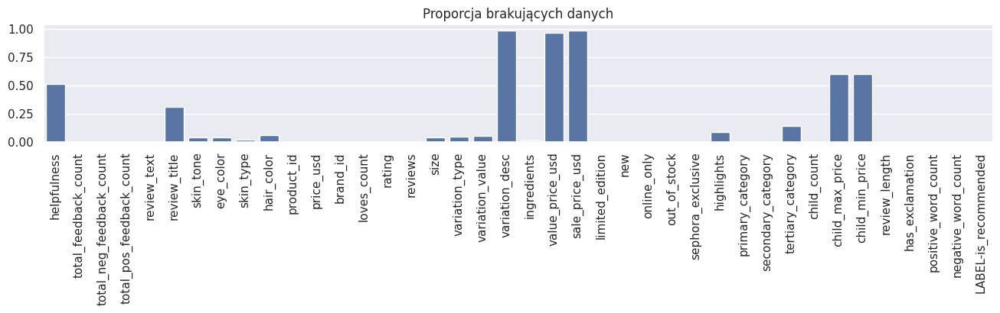

In [8]:
plt.figure(figsize=(16,2))
plt.xticks(rotation=90)
sns.barplot(df.isnull().sum()/len(df))
plt.title("Proporcja brakujących danych")

#### Correlation Matrix
The correlation matrix highlights typical linear relationships among features related to price, such as `price_usd`, `value_price_usd`, and similar ones, as well as features associated with feedback information, represented in the format `..._feedback_...`.

Importantly, the vast majority of features do not exhibit strong correlation with the target variable. However, there are some notable exceptions, such as `rating` and `sale_price_usd`. Additionally, the engineered features `has_exclamation`, `positive_word_count`, and `negative_word_count` stand out. The first two show positive correlation, suggesting a possible association with positive reviews. The presence of an exclamation mark in a review may indicate excitement triggered by the product. The count of positive and negative words also has a clear and intuitive explanation, accounting for their respective positive and negative correlations.

Unfortunately, the correlation coefficients for these features do not exceed 0.4 in absolute value, ultimately indicating only weak linear relationships.


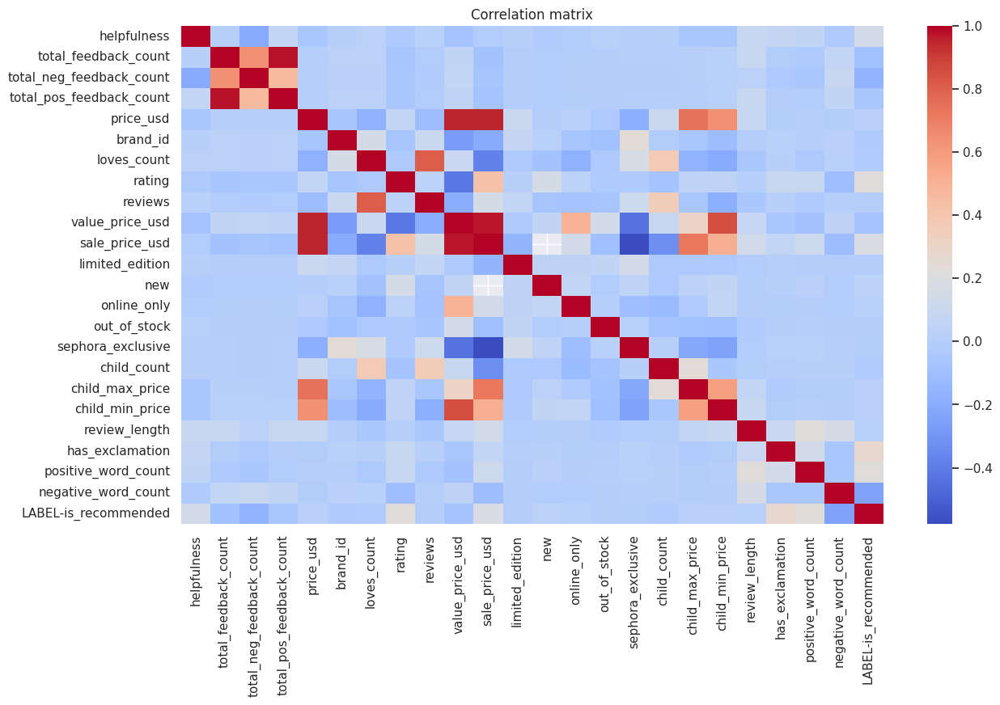

In [9]:
df_all_numeric = df.select_dtypes(include=['int64', 'float64'])
correlation_matrix = df_all_numeric.corr()

plt.figure(figsize=(14, 8))
sns.heatmap(correlation_matrix, cmap='coolwarm', fmt=".2f")

plt.title("Correlation matrix")
plt.show()

To facilitate further analysis of individual features, we will split the dataset into three smaller subsets containing, respectively: categorical, numerical, and textual data.


In [10]:
categorical = ['LABEL-is_recommended','skin_tone','eye_color','skin_type','hair_color','variation_type',
               'variation_desc','limited_edition','new','online_only','out_of_stock','sephora_exclusive','primary_category',
               'secondary_category','tertiary_category','has_exclamation', 'brand_id']
numerical = ['helpfulness','total_feedback_count','total_neg_feedback_count','total_pos_feedback_count',
             'price_usd','loves_count','rating','reviews','value_price_usd','sale_price_usd','child_count','child_max_price',
             'child_min_price','review_length','positive_word_count','negative_word_count']
text = ['review_text','review_title','product_id','size','variation_value','ingredients','highlights']


## 2. Numerical Data Analysis

Below are basic statistics for the numerical data

In [11]:
df[numerical].describe()

,helpfulness,total_feedback_count,total_neg_feedback_count,total_pos_feedback_count,price_usd,loves_count,rating,reviews,value_price_usd,sale_price_usd,child_count,child_max_price,child_min_price,review_length,positive_word_count,negative_word_count
count,359742.000000,741138.000000,741138.000000,741138.000000,741138.000000,7.411380e+05,741138.000000,741138.000000,20950.000000,6397.000000,741138.000000,294942.000000,294942.000000,739982.000000,741138.000000,741138.000000
mean,0.765295,4.131498,0.916870,3.214628,50.040677,1.091375e+05,4.296315,2048.096848,112.529424,17.779962,0.747781,58.669932,31.317878,318.175460,1.250133,0.090245
std,0.318143,22.851803,5.388445,19.879576,41.094844,1.781027e+05,0.290122,2531.892571,61.359340,14.373937,1.286717,64.039113,29.816067,226.138713,1.204210,0.341016
min,0.000000,0.000000,0.000000,0.000000,3.000000,0.000000e+00,1.000000,1.000000,20.000000,3.000000,0.000000,3.000000,3.000000,16.000000,0.000000,0.000000
25%,0.625000,0.000000,0.000000,0.000000,25.000000,1.437600e+04,4.147200,512.000000,68.000000,7.000000,0.000000,21.000000,18.000000,173.000000,0.000000,0.000000
50%,0.923077,0.000000,0.000000,0.000000,40.000000,4.444800e+04,4.345600,1229.000000,102.000000,18.000000,0.000000,38.000000,22.000000,262.000000,1.000000,0.000000
75%,1.000000,3.000000,1.000000,3.000000,65.000000,1.216780e+05,4.495800,2561.000000,142.000000,27.000000,1.000000,68.000000,30.000000,398.000000,2.000000,0.000000
max,1.000000,5464.000000,1159.000000,5050.000000,1900.000000,1.081315e+06,5.000000,16118.000000,480.000000,320.000000,13.000000,570.000000,365.000000,2000.000000,84.000000,13.000000


For visualization purposes, boxplots were created for each variable. Due to the large dataset size, a random sample of 200,000 records was selected.

The distribution of numerical data shows significant discrepancies in the values of individual attributes — standardization will be necessary for most models.


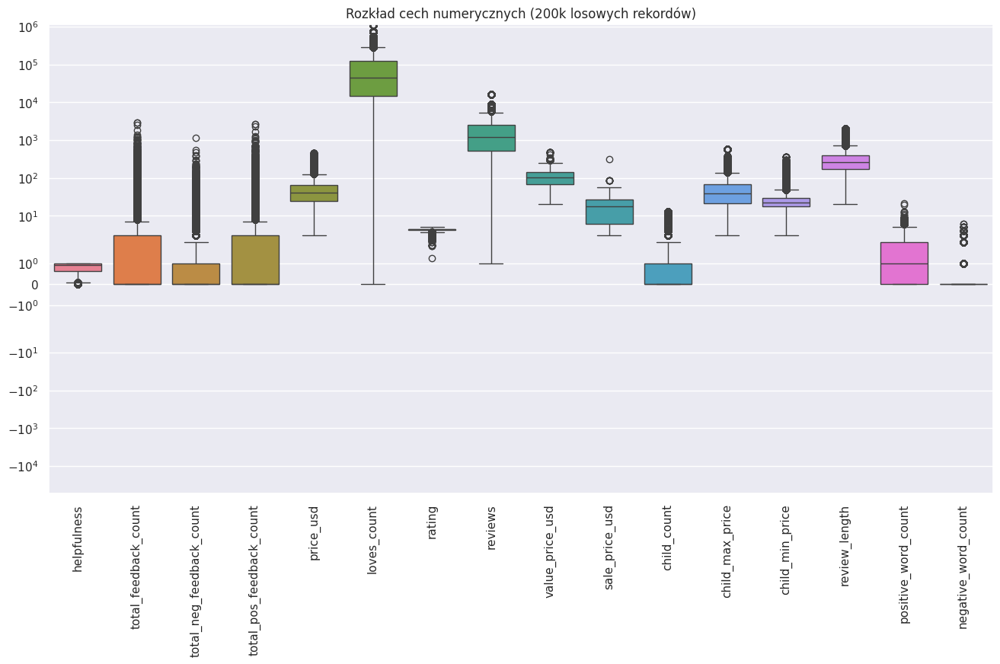

In [12]:
import warnings
warnings.filterwarnings('ignore')

plt.figure(figsize=(16, 8))
sns.boxplot(df[numerical].sample(n=200_000, random_state=42))
plt.xticks(rotation=90)
plt.yscale('symlog')
plt.title("Rozkład cech numerycznych (200k losowych rekordów)")
plt.show()

#### PCA
The next visualization method we used is PCA. Since it does not work properly with missing data, we will omit columns with a high proportion of missing values: `value_price_usd`, `sale_price_usd`, `child_max_price`, `child_min_price`, and `helpfulness`. Otherwise, removing samples with *NaN* values would excessively reduce the dataset size.

For both the first 2 and 3 components, we observe that the classes under consideration are not easily separable, indicating that an effective classification model will require a larger number of features.


In [13]:
df_num = df[list(set(numerical + ['LABEL-is_recommended']) - set(['value_price_usd', 'sale_price_usd', 'child_max_price', 'child_min_price', 'helpfullness']))]
df_num = df_num.dropna()

In [14]:
y = df_num['LABEL-is_recommended']
X = df_num.drop(columns=['LABEL-is_recommended'])

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X)

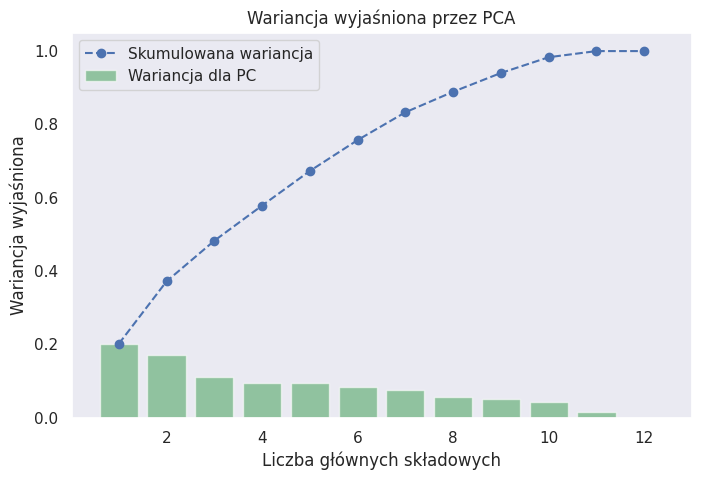

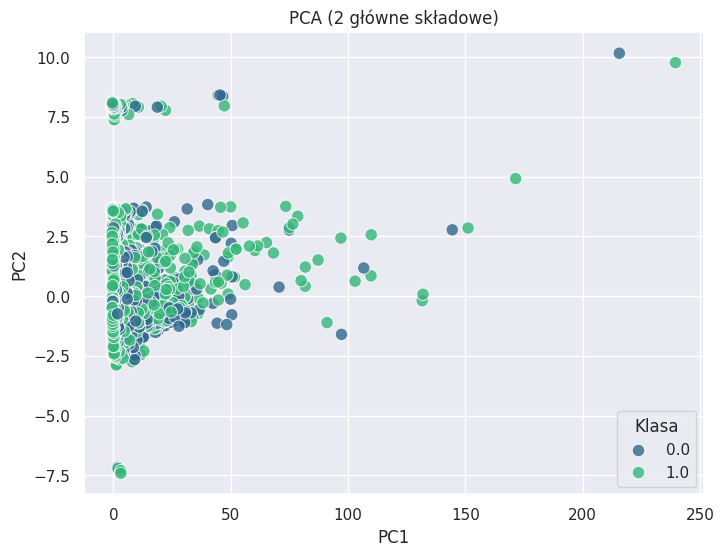

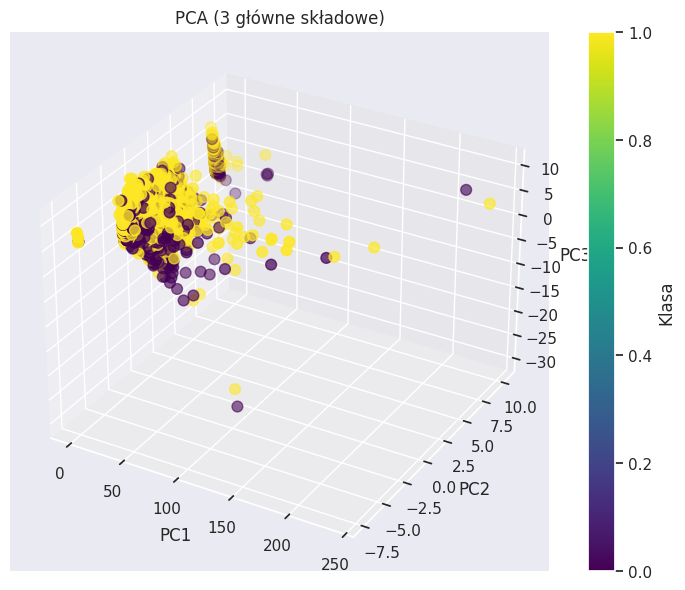

In [ ]:
n = 12
pca = PCA(n_components=n)
X_pca = pca.fit_transform(X_train_scaled)

# Explained variance ratio
explained_variance = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance)

# chart of cumulative variance
plt.figure(figsize=(8, 5))
plt.plot(range(1, n+1), cumulative_variance, marker='o', linestyle='--', color='b', label="Skumulowana wariancja")
plt.bar(range(1, n+1), explained_variance, alpha=0.6, color='g', label="Wariancja dla PC")
plt.xlabel('Liczba głównych składowych')
plt.ylabel('Wariancja wyjaśniona')
plt.title('Wariancja wyjaśniona przez PCA')
plt.legend()
plt.grid()
plt.show()

# PCA in 2D dimension
pca_2d_df = pd.DataFrame(X_pca[:, :2], columns=["PC1", "PC2"])
pca_2d_df["class"] = y.reset_index(drop=True)

plt.figure(figsize=(8, 6))
sns.scatterplot(data=pca_2d_df, x="PC1", y="PC2", hue="class", palette="viridis", s=80, alpha=0.8)
plt.title("PCA (2 główne składowe)")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.legend(title="Klasa")
plt.show()

#  PCA in 3D dimension
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(X_pca[:, 0], X_pca[:, 1], X_pca[:, 2], c=y.reset_index(drop=True), cmap="viridis", s=60)
ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")
plt.title("PCA (3 główne składowe)")
plt.colorbar(scatter, label="Klasa")
plt.show()


#### Additional Question: Is the number of likes for a product related to its price?

Analyzing the plot, we can conclude that products with the highest number of likes often have a low price. As the product’s price increases, the number of likes noticeably decreases. However, the vast majority of observations cluster in the lower-left corner of both scatter plots. This means that most products have both a low price and a low number of likes, and there is no clear direct relationship between these two features.


array([[<Axes: xlabel='loves_count', ylabel='loves_count'>,
        <Axes: xlabel='price_usd', ylabel='loves_count'>],
       [<Axes: xlabel='loves_count', ylabel='price_usd'>,
        <Axes: xlabel='price_usd', ylabel='price_usd'>]], dtype=object)

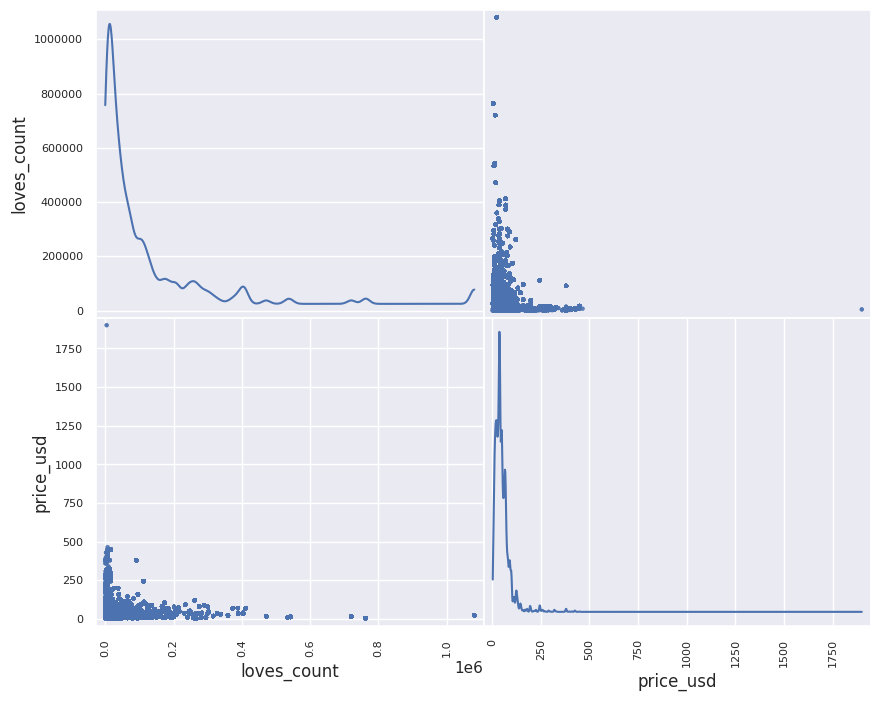

In [16]:
scatter_matrix(df[['loves_count', 'price_usd']], alpha=0.5, figsize=(10, 8), diagonal="kde")

## 3. Categorical Data Analysis
By examining sample categorical data, we can observe many disparities across individual features.


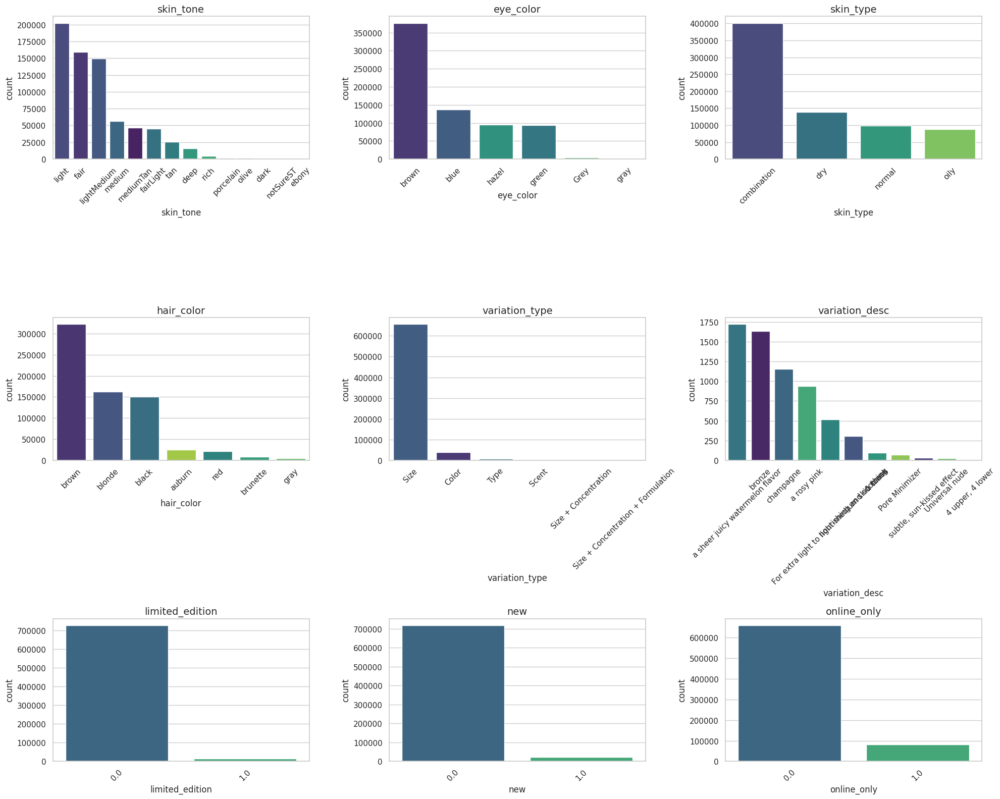

In [17]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

sns.set_style("whitegrid")

max_categories = 15  

fig, axes = plt.subplots(3, 3, figsize=(20, 16)) 
axes = axes.flatten()  

for i, col in enumerate(categorical[1:10]):
    unique_values = df[col].nunique()
    
    sns.countplot(data=df, x=col, hue=col, order=df[col].value_counts().index, palette="viridis", ax=axes[i])
    axes[i].legend_.remove() 
    axes[i].set_title(f"{col}", fontsize=14)
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()


## 3. Text Data Analysis

The dominant word in review titles and content is *skin*, naturally excluding common words like *it*, *and*, etc. Along with the word *product*, which ranks second, these are intuitive leaders since we are analyzing data related to skincare products. An interesting word in third place is *but*, which often serves as a negation or expression of surprise and carries some emotional connotation. Also worth noting is the word *love*, which ranks fourth among the most frequent words and has a clearly positive sentiment.


In [ ]:
import re
from collections import Counter

unnecesary_words = {'i', 'it', 'and', 'the', 'my', 'to', 'a', 'is', 'in', 'this', 'of',
                     'for', 'on', 'with', 'you', 's', 't', 'have', 'so', 'that'}

texts = df['review_text'].dropna().tolist() + df['review_title'].dropna().tolist()

def preprocess_text(text):
    text = text.lower()  
    text = re.sub(r'\W+', ' ', text)  
    words = text.split()  
    words = [word for word in words if word not in unnecesary_words]  
    return words

all_words = []
for text in texts:
    all_words.extend(preprocess_text(text))

word_freq = Counter(all_words)
common_words = word_freq.most_common(20)

for word, freq in common_words:
    print(f'{word}: {freq}')


skin: 921677
product: 490216
but: 444848
love: 339650
not: 322978
was: 272477
like: 258294
use: 256367
face: 230692
as: 229623
me: 212794
using: 206641
really: 202629
great: 194262
very: 193021
after: 189167
has: 173724
out: 160412
dry: 159527
all: 151719


In [19]:
most_frequent = ['skin', 'product', 'but', 'love', 'not']

We will now analyze the number of reviews and their class proportions in which the selected words—chosen from the 5 most popular—did or did not appear.

The least informative word proved to be *product*, which showed identical proportions in both cases for both classes. The results for the word *love* were as expected — when it appeared in a review, it was highly likely to be positive. On the other hand, the words *but* and *not* showed weaker results — their presence was more often associated with negative reviews.


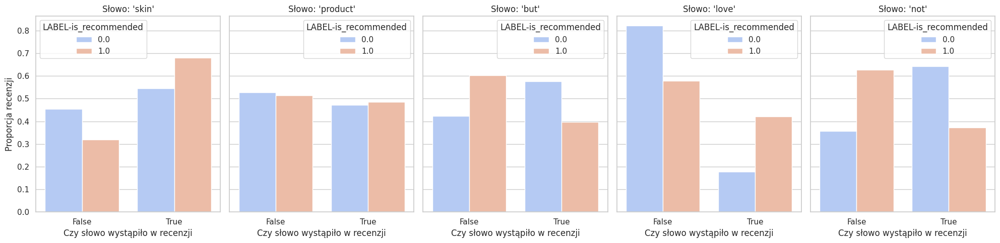

In [20]:
df_new = df[['LABEL-is_recommended','review_title', 'review_text']]

fig, axes = plt.subplots(nrows=1, ncols=len(most_frequent), figsize=(20, 5), sharey=True)

for i, word in enumerate(most_frequent):
    df_new[word] = df_new['review_text'].fillna('').str.contains(word, case=False) | df_new['review_title'].fillna('').str.contains(word, case=False) # Tworzenie kolumny True/False czy słowo się pojawiło

    counts = df_new.groupby(['LABEL-is_recommended', word]).size().reset_index(name='count') # Grupowanie i liczenie

    total_per_class = df_new.groupby('LABEL-is_recommended').size().reset_index(name='total')
    merged = counts.merge(total_per_class, on='LABEL-is_recommended')
    merged['proportion'] = merged['count'] / merged['total']

    sns.barplot(
        data=merged,
        x=word,
        y='proportion',
        hue='LABEL-is_recommended',
        ax=axes[i],
        palette='coolwarm'
    )
    axes[i].set_title(f"Słowo: '{word}'")
    axes[i].set_xlabel("Czy słowo wystąpiło w recenzji")
    axes[i].set_ylabel("Proporcja recenzji")

plt.tight_layout()
plt.show()

### Does the distribution of review length differ between classes?  
Analyzing the normalized histograms of review length (number of characters), we can conclude that the distributions are quite similar. The only difference is that positive reviews tend to have more records with lengths between 250 and 350 characters. However, from a broader perspective, these distributions do not indicate a significant difference in review length between the classes.


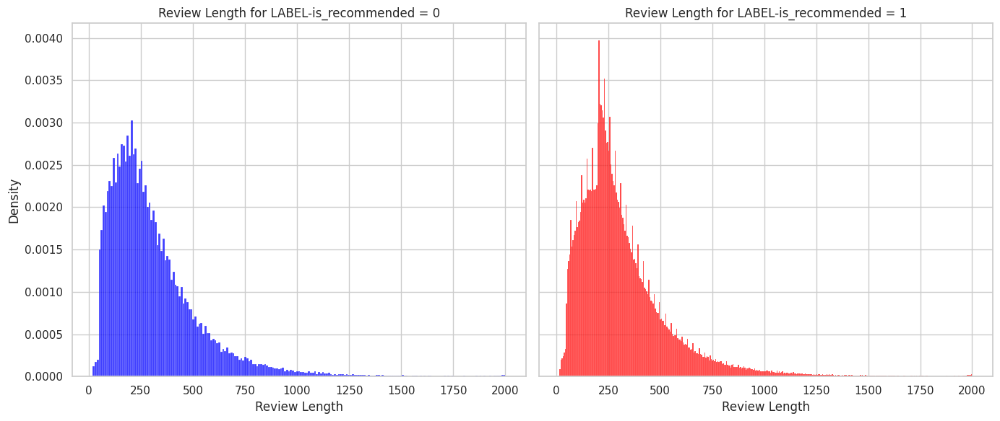

In [21]:
df_0 = df[df['LABEL-is_recommended'] == 0]
df_1 = df[df['LABEL-is_recommended'] == 1]

fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)

sns.histplot(df_0['review_length'], kde=False, stat='density', color='blue', ax=axes[0])
axes[0].set_title("Review Length for LABEL-is_recommended = 0")
axes[0].set_xlabel("Review Length")
axes[0].set_ylabel("Density")

sns.histplot(df_1['review_length'], kde=False, stat='density', color='red', ax=axes[1])
axes[1].set_title("Review Length for LABEL-is_recommended = 1")
axes[1].set_xlabel("Review Length")
axes[1].set_ylabel("Density")

plt.tight_layout()
plt.show()


##### Does the dataset seem sufficiently informative to solve the sentiment analysis task?

This dataset is primarily characterized by a significant volume of data (almost 750,000 records) containing key information about labels — whether a product was recommended by the customer or not. Additionally, it includes crucial elements such as product ratings on a scale from 1 to 5, review titles and content, as well as counts of positively and negatively charged words used. Overall, it appears to be an adequately informative dataset for the sentiment analysis task.

To achieve the best results, applying advanced NLP techniques may prove important, especially considering the presence of the aforementioned features — review titles and content — which likely carry the most information. Another worthwhile step would be to eliminate potential noise by removing uninformative columns or handling missing values, which is feasible given the large dataset size.
